## Correlation Heatmap

This simple project provides users with a basic a tool that computes and compare how correlation varies across different assets (equities indices, FX pairs, rates and commodities). From the use of rolling correlations, we will show how relationships changes in stress periods versus calm markets. This is especially useful when it serves the context of demonstrating portfolio thinking, diversification logic and systemic risk awareness.

The notebook will be divided into the following sections:
- Initialisation of parameters
- Importing of datasets
- Computation of rolling correlations through the use of simple lookback windows
- Visualisation of asset relationships through the use of correlation heatmaps


In [123]:
import pandas as pd
import numpy as np
import math
import yfinance as yf
import seaborn as sns
import warnings
from matplotlib.animation import FuncAnimation
from matplotlib import pyplot as plt
from IPython.display import HTML
warnings.filterwarnings("ignore", category=FutureWarning)

#### Importing Data

We will be using ```yfinance``` to download our historical price data for our assets. We will be performing the analysis over a period of 5 years from 2020 to 2025, which should also capture some macro-shocks within this timeframe. 

In [149]:
start_date, end_date = "2020-01-01", "2025-12-31"
stocks_tickers = ["AAPL", "MSFT", "GOOGL", "AMZN", "TSLA", "META", "NVDA", "JPM", "V", "JNJ"]
fx_pairs = ["EURUSD=X", "GBPUSD=X", "USDJPY=X", "AUDUSD=X", "USDCAD=X", "USDCHF=X", "NZDUSD=X"]
commodities_tickers = ["GC=F", "SI=F", "CL=F", "NG=F", "HG=F", "ZC=F", "ZS=F"]
rates_tickers = ["^TNX", "^IRX", "^TYX", "^FVX"]

# Periods of Black Swan Events or Macro Shocks
macro_shocks = {
  "Global Financial Crisis": ("2008-09-15", "2009-03-09"),
  "European Debt Crisis": ("2010-04-23", "2012-07-31"),
  "US Debt Ceiling Crisis & S&P Downgrade": ("2011-07-25", "2011-10-14"),
  "Chinese Stock Market Turbulence": ("2015-06-12", "2015-09-30"),
  "Brexit Referendum": ("2016-06-23", "2016-07-11"),
  "2018 Stock Market Sell-Off": ("2018-01-26", "2018-02-08"),
  "US Tariff Imposition on China": ("2018-03-22", "2018-06-15"),
  "COVID-19 Pandemic": ("2020-02-20", "2020-03-23"),
  "Russia–Ukraine War": ("2022-02-24", "2022-03-08"),
  "US Regional Banking Crisis (SVB, Signature)": ("2023-03-08", "2023-03-17"),
  "US Debt Ceiling Crisis": ("2023-05-29", "2023-06-03"),
  "US Liberation Day 2025": ("2025-04-01", "2025-04-15"),
}

In [125]:
# Define a function to store all our datasets into a pandas dataframe for each of the above asset classes
def download_historical_data(tickers, start_date, end_date):
  data = yf.download(tickers, start=start_date, end=end_date)['Close']
  # Collapse the multi-level column index
  data.reset_index(inplace=True)
  # Set index to Date
  data.set_index('Date', inplace=True)
  return data

In [126]:
stocks = download_historical_data(stocks_tickers, start_date, end_date)
fx = download_historical_data(fx_pairs, start_date, end_date)
commodities = download_historical_data(commodities_tickers, start_date, end_date)
rates = download_historical_data(rates_tickers, start_date, end_date)

[*********************100%***********************]  10 of 10 completed
[*********************100%***********************]  7 of 7 completed
[*********************100%***********************]  7 of 7 completed
[*********************100%***********************]  4 of 4 completed


Visualise each of the above assets' prices over the period of analysis

In [127]:
def visualise_data(dataframe, asset_class):
  # Plot all the time series data for the assets in the dataframe
  plt.figure(figsize=(18, 6))
  for column in dataframe.columns:
    plt.plot(dataframe.index, dataframe[column], label=column)
  plt.xlabel('Date')
  plt.ylabel('Price')
  plt.title(f'{asset_class} Prices Over Time')
  plt.legend()
  plt.show()

Let us visualise stocks and rates across time

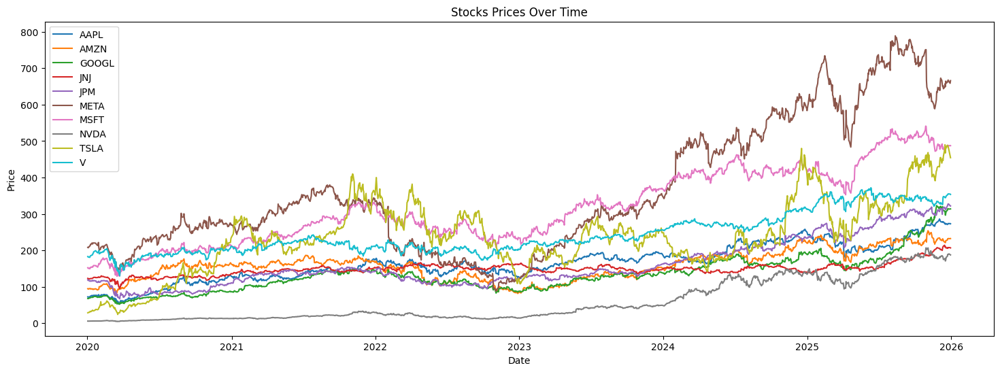

In [128]:
visualise_data(stocks, 'Stocks')

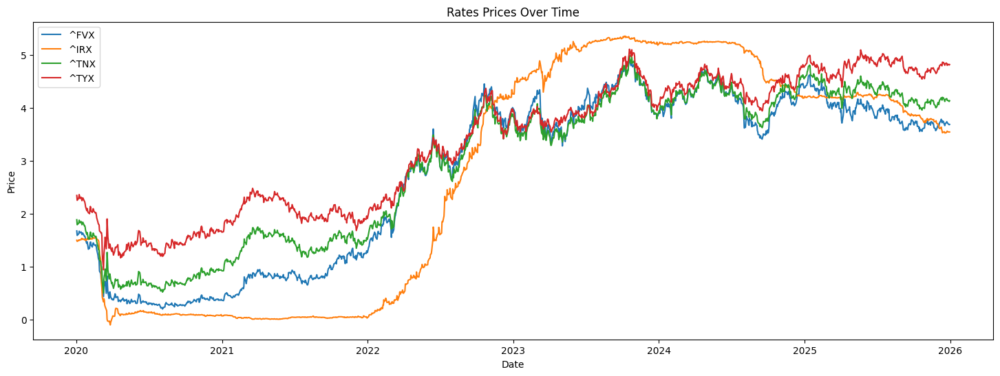

In [129]:
visualise_data(rates, 'Rates')

From observing the price charts alone, we can see some co-movement between the various assets. Now, let us define the function to compute the rolling correlations across time.

### Rolling Correlation

The rolling correlation differs from our normal asset correlation, in that instead of computing correlation across the entire period, we are using a rolling window function to compute the correlation of the assets during those period. Mathematically, it can be defined as follow:
$$
\rho_t^{(X,Y)} =
\frac{
\sum_{i=0}^{n-1}
\left(X_{t-i} - \bar{X}_t\right)
\left(Y_{t-i} - \bar{Y}_t\right)
}{
\sqrt{
\sum_{i=0}^{n-1}
\left(X_{t-i} - \bar{X}_t\right)^2
}
\sqrt{
\sum_{i=0}^{n-1}
\left(Y_{t-i} - \bar{Y}_t\right)^2
}
}
$$

where:

- $n$ is the rolling window length  
- $\bar{X}_t$ = $\frac{1}{n}\sum_{i=0}^{n-1} X_{t-i}$ is the rolling mean of \(X\)  
- $\bar{Y}_t$ = $\frac{1}{n}\sum_{i=0}^{n-1} Y_{t-i}$ is the rolling mean of \(Y\)

In [139]:
def rolling_correlation_computation(dataframe, window_size):
  # Create a copy of the dataframe to avoid modifying the original data
  df = dataframe.copy()
  # Compute the log returns
  log_returns = np.log(df / df.shift(1))
  rolling_corr = log_returns.rolling(window=window_size).corr()
  return rolling_corr

# Average rolling correlation as a single time series
def rolling_mean_correlation_computation(dataframe, window_size):
  # Create a copy of the dataframe to avoid modifying the original data
  df = dataframe.copy()
  # Compute the log returns
  log_returns = np.log(df / df.shift(1))
  rolled = log_returns.rolling(window=window_size).corr()
  # Average all pairwise correlations (excluding diagonal)
  avg_corr = rolled.groupby(level=0).apply(lambda x: x.values[np.triu_indices_from(x, k=1)].mean())
  return avg_corr

In [142]:
avg_stocks_corr = rolling_mean_correlation_computation(stocks, window_size=30)
avg_fx_corr = rolling_mean_correlation_computation(fx, window_size=30)
avg_commodities_corr = rolling_mean_correlation_computation(commodities, window_size=30)
avg_rates_corr = rolling_mean_correlation_computation(rates, window_size=30)

/Users/kevintanyuejun/opt/anaconda3/envs/llm_ai_modelling/lib/python3.10/site-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)
/Users/kevintanyuejun/opt/anaconda3/envs/llm_ai_modelling/lib/python3.10/site-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


In [143]:
stocks_rolling_corr = rolling_correlation_computation(stocks, window_size=30)
fx_rolling_corr = rolling_correlation_computation(fx, window_size=30)
commodities_rolling_corr = rolling_correlation_computation(commodities, window_size=30)
rates_rolling_corr = rolling_correlation_computation(rates, window_size=30)

/Users/kevintanyuejun/opt/anaconda3/envs/llm_ai_modelling/lib/python3.10/site-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)
/Users/kevintanyuejun/opt/anaconda3/envs/llm_ai_modelling/lib/python3.10/site-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


In [156]:
def dynamic_correlation_heatmap(rolling_corr_matrices, start_date, end_date):
  """
  Create a dynamic heatmap animation of rolling correlation matrices.

  Args:
    rolling_corr_matrices (dict): {date: correlation_matrix}
    start_date (str or Timestamp)
    end_date (str or Timestamp)
  """
  # Slice date range
  sliced = rolling_corr_matrices.loc[pd.IndexSlice[start_date:end_date, :], :]
  # Get unique dates
  dates = sliced.index.get_level_values(0).unique()
  assets_corr = sliced.columns.tolist()
  
  fig, ax = plt.subplots(figsize=(8, 6))

  # Create a dedicated colorbar axis
  cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])
  def update(i):
    ax.clear()
    cbar_ax.clear()
    date = dates[i]
    # Extract NxN correlation matrix for this date
    corr_matrix = (sliced.loc[date].reindex(index=assets_corr, columns=assets_corr))
    sns.heatmap(corr_matrix, cmap="coolwarm", vmin=-1, vmax=1, square=True, cbar=True, cbar_ax=cbar_ax, ax=ax)
    ax.set_title(f"Rolling Correlation Heatmap — {date.date()}")

  ani = FuncAnimation(fig, update, frames=len(dates), interval=500)
  plt.close(fig)
  return HTML(ani.to_jshtml())

def avg_rolling_correlation_plot(avg_corr, asset_class):
  fig, ax = plt.subplots(figsize=(18, 6), sharex=True)
  # Plot average rolling correlation time series
  ax.plot(avg_corr.index, avg_corr.values, label=f'Average Rolling Correlation ({asset_class})', linewidth=2)
  
  # Include a vertical line for each macro shock period if it falls within the date range in our avg_corr index
  for event, (start, end) in macro_shocks.items():
    if start in avg_corr.index and end in avg_corr.index:
      ax.axvspan(pd.to_datetime(start), pd.to_datetime(end), color='red', alpha=0.3, label=event)

  ax.set_xlabel('Date')
  ax.set_ylabel('Average Correlation')
  ax.set_title(f'Average Rolling Correlation Over Time - {asset_class}')
  ax.legend(loc="upper right")
  plt.show()

Visualise the plots

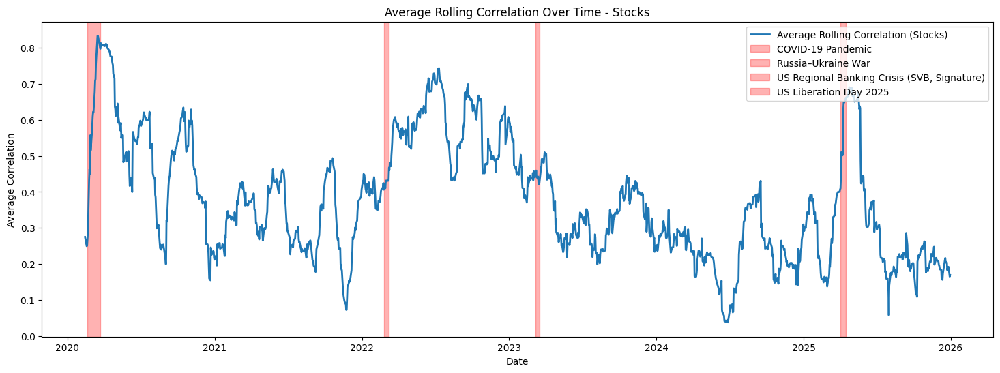

In [157]:
avg_rolling_correlation_plot(avg_stocks_corr, 'Stocks')

In [136]:
dynamic_correlation_heatmap(stocks_rolling_corr, '2022-01-01', '2022-05-31')

You can adjust the parameters and timeframe to observe different periods for our correlation heatmap.

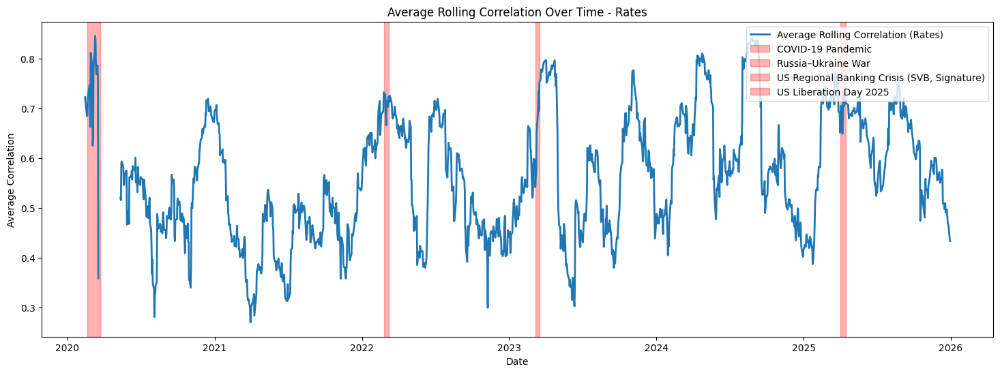

In [159]:
avg_rolling_correlation_plot(avg_rates_corr, 'Rates')

In [161]:
dynamic_correlation_heatmap(rates_rolling_corr, '2022-01-01', '2022-05-31')

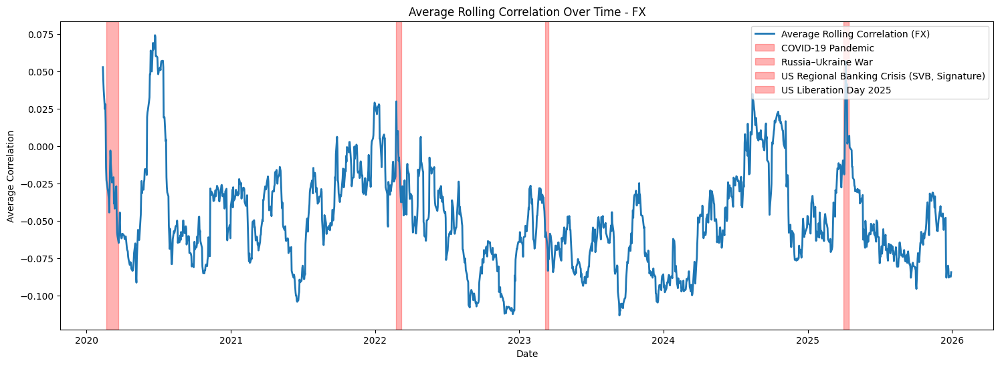

In [162]:
avg_rolling_correlation_plot(avg_fx_corr, 'FX')

In [163]:
dynamic_correlation_heatmap(fx_rolling_corr, '2022-01-01', '2022-05-31')

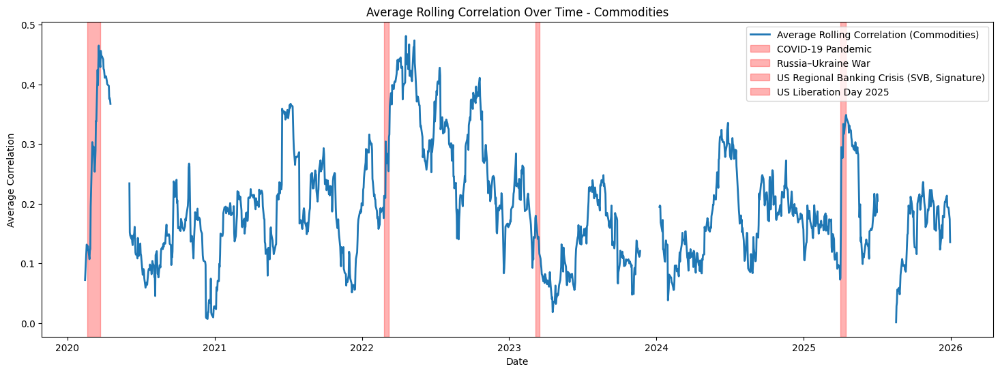

In [164]:
avg_rolling_correlation_plot(avg_commodities_corr, 'Commodities')

In [165]:
dynamic_correlation_heatmap(commodities_rolling_corr, '2022-01-01', '2022-05-31')

### Expanding the Rolling Correlation Analysis

We will now study how a given asset of our choice correlates with their peers on a rolling basis. A few tweaks to the existing code above would do the job. On top of that, we can also group by the asset class or sectors to see whether correlation exists on a sector and class level.